<a href="https://colab.research.google.com/github/zfurman56/mean-field/blob/main/mean-field.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##What is the mean-field theory of neural networks, and why should you care?

The way we train neural networks looks like this:

1. Initialize your parameters from a distribution.
2. Run SGD for some duration with your loss function.
3. Take the resulting parameters.

But this framing hides some messiness! The process isn't quite deterministic. The final parameters depend on the specific initialization and gradient noise your training run experienced. That means that *implicitly*, there's some probability distribution over the trained parameters too, if you were to have many training runs.

If we want to give odds for what algorithms neural networks will learn, without talking about training details, we need this distribution, one way or the other. Mean-field theory gives us a way to get it.

##Diffusion and the Heat Equation

To explain how to do this, we'll start with a more familiar situation from physics.

Suppose I drop some ink in a cup of water and leave it for a bit. You can probably picture in your head how the ink will spread out over time.

But how did you do this? Both the ink and the water are made of trillions upon trillions of individual molecules! In order to reason about this, it seems like you should have to think about every single one - but you don't.

Each individual ink molecule bounces around quasi-randomly, but when you have lots of molecules, it all averages out. The *cumulative* motion is deterministic and easy to predict.

We started with a stochastic process on each particle's position, but ended with a deterministic process on the density of particles. Formally, the first one is a stochastic differential equation (SDE), the second is a partial differential equation (PDE), and the bridge between the two is made by the Feynman-Kac theorem.

The intuition seems almost obvious, but it's worth noting that, from a mathematical perspective, this is quite surprising! The motion of individual free particles (Brownian dynamics) is governed by a stochastic equation that looks like this:

$$\dot{X}(t) = R(t)$$

$$\text{where } R(t) \sim \mathcal{N}(0, 1)$$

But the macroscopic equation for diffusion (the heat equation) is a deterministic equation that looks like this:

$$\frac{\partial u}{\partial t} = \Delta u$$

They're very different types of objects, mathematically. I won't dwell on an explanation of Feynman-Kac here, but it's worth noting how strange this is!


## Does this really work in practice?

Yes! Let's try it ourselves.

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import torch
import torch.nn as nn
import torch.optim as optim

torch.manual_seed(42)
np.random.seed(42)

We'll start by simulating the dynamics of a particle stuck in a well, defined by the equation $U(x) = (x-3)^2$. We'll start it in a random (normally distributed) position around $x=5$.

Its motion is governed by two things:
1. The force of the well, pushing it towards $x=3$.
2. Random "jolts", to simulate bumping into other particles.

We'll simulate 10,000 of these particles, and see where they end up:

In [38]:
# 
def force(x):
    return -2 * (x - 3)

# Brownian dynamics simulation
def brownian_dynamics(n_particles, n_timesteps, dt, alpha, beta, x0=None):
    if x0 is None:
        x0 = np.zeros(n_particles)
        
    x = np.zeros((n_timesteps, n_particles))
    x[0] = x0

    for t in range(1, n_timesteps):
        x[t] = x[t - 1] + alpha * beta * force(x[t - 1]) * dt + np.sqrt(2 * alpha * dt) * np.random.normal(0, 1, n_particles)

    return x

# Simulation parameters
L = 10 # width
n_particles = 10000
n_timesteps = 1000
dt = 0.001
alpha = 1  # Diffusion coefficient
beta = 4  # Potential coefficient

# Run the simulation
x0 = np.random.normal(L / 2, 1, n_particles)
x = brownian_dynamics(n_particles, n_timesteps, dt, alpha, beta, x0)

# Create a 2D histogram to visualize the density of states over time
hist, x_edges, y_edges = np.histogram2d(x.flatten(), np.repeat(np.arange(n_timesteps), n_particles), bins=[100, n_timesteps], range=[[0, L], [0, n_timesteps]], density=True)

# Use Plotly to create a 2D image plot
fig = go.Figure(data=go.Heatmap(z=hist.T, x=x_edges, y=y_edges, colorscale="inferno"))
fig.update_layout(xaxis_title="Position", yaxis_title="Time", width=600, height=600)
fig.show()

Now we'll ditch the individual particles and model the probability distribution directly. This equation is called the [Smoluchowski diffusion equation](https://en.wikipedia.org/wiki/Fokker%E2%80%93Planck_equation#Smoluchowski_diffusion_equation):

$$\partial_t P(r,t| r_0, t_0) = \nabla \cdot [D (\nabla - \beta F(r)) P(r,t| r_0, t_0)]$$

(You can derive this from the stochastic equation from the previous step, but we won't do that here.)

This is a PDE, and we can just simulate it with a finite-element method:

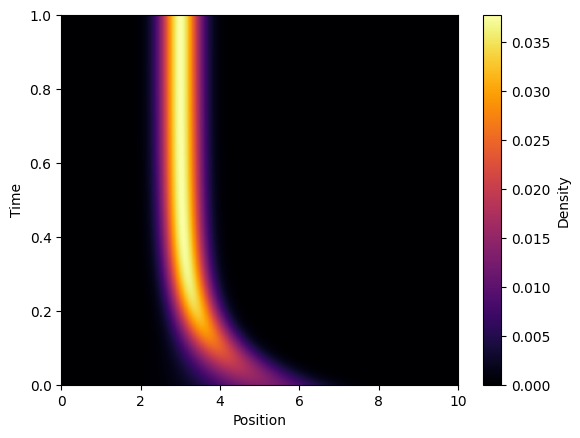

In [39]:
# Parameters
N = 300  # Number of spatial points
L = 10  # Spatial domain size
dx = L / (N - 1)  # Spatial step
T = 1  # Total time

alpha = 1  # Diffusion coefficient
beta = 4  # Potential coefficient

# Set time step based on CFL condition
cfl_factor = 0.9  # Choose a factor less than 1 for stability
dt = cfl_factor * dx**2 / (2 * alpha)  # Time step based on CFL condition
nt = int(T / dt)  # Number of time steps

# Initialize the solution and x-axis arrays
u = np.zeros((nt, N))
x = np.linspace(0, L, N)

# Set initial condition
u[0][1:-1] = np.exp(-0.5 * (x[1:-1] - L / 2)**2)  # Gaussian distribution
u[0] /= np.sum(u[0, 1:-1])  # Normalize

# Time integration loop
for t in range(1, nt):
    u_plus = np.roll(u[t - 1], -1)
    u_minus = np.roll(u[t - 1], 1)
    u_xx = (u_plus - 2 * u[t - 1] + u_minus) / dx**2

    Vx = -2 * (x - 3)
    uVx = Vx * u[t - 1]
    div_uV = (np.roll(uVx, -1) - np.roll(uVx, 1)) / (2*dx)

    du_dt = alpha * u_xx - alpha * beta * div_uV
    u[t, 1:-1] = u[t - 1, 1:-1] + dt * du_dt[1:-1]

    # Apply zero-flux boundary conditions
    u[t, 0] = 0
    u[t, -1] = 0


# Plot the solution
plt.figure()
plt.imshow(u, extent=[0, L, 0, T], origin='lower',
           aspect='auto', cmap='inferno')
plt.xlabel('Position')
plt.ylabel('Time')
plt.colorbar(label='Density')
plt.show()


The theory was correct! Despite being calculated in completely different ways, our two graphs are almost identical. The particle tends to move towards $x=3$, but bounce around near that point. Feel free to play around with the above if you want to build this intuition.

For fun, we'll do the same thing for a particle in a 2D well defined by $U(x, y) = x^2y^2$. The resulting distribution looks pretty cool:

In [25]:
# Parameters
N = 50  # Number of spatial points
L = 10  # Spatial domain size
dx = L / (N - 1)  # Spatial step
T = 2  # Total time
frame_stride = 1000

alpha = 1  # Diffusion coefficient
beta = 2  # Potential coefficient

# Set time step based on CFL condition
cfl_factor = 0.001  # Choose a factor less than 1 for stability
dt = cfl_factor * dx**2 / (4 * alpha)  # Time step based on CFL condition
nt = int(T / dt)  # Number of time steps

# Initialize the solution and x-axis and y-axis arrays
u = np.zeros((nt, N, N))
x, y = np.linspace(0, L, N), np.linspace(0, L, N)
X, Y = np.meshgrid(x, y)

# Set initial condition
u[0] = np.exp(-0.5 * (X - L / 2)**2 - 0.5 * (Y - L / 2)**2)  # Gaussian distribution
u[0] /= np.sum(u[0]) * dx * dx  # Normalize

# Time integration loop
for t in range(1, nt):
    u_xx = (u[t - 1, 2:, 1:-1] - 2 * u[t - 1, 1:-1, 1:-1] + u[t - 1, :-2, 1:-1]) / dx**2
    u_yy = (u[t - 1, 1:-1, 2:] - 2 * u[t - 1, 1:-1, 1:-1] + u[t - 1, 1:-1, :-2]) / dx**2

    Vx = -2 * (X - 5) * ((Y - 5)**2)
    Vy = -2 * (Y - 5) * ((X - 5)**2)
    Vx_u = Vx * u[t-1]
    Vy_u = Vy * u[t-1]
    
    div_uV = (((Vx_u[1:-1, 2:] - Vx_u[1:-1, :-2]) / (2 * dx)) +
              ((Vy_u[2:, 1:-1] - Vy_u[:-2, 1:-1]) / (2 * dx)))
    
    du_dt = alpha * (u_xx + u_yy) - beta * div_uV

    u[t, 1:-1, 1:-1] = u[t - 1, 1:-1, 1:-1] + dt * du_dt

    # Apply boundary conditions (assuming zero flux at boundaries)
    u[t, 0, :] = 0
    u[t, -1, :] = 0
    u[t, :, 0] = 0
    u[t, :, -1] = 0


# Create Plotly figure with a slider
traces = [go.Surface(x=X, y=Y, z=u[t], colorscale='inferno', visible=False) for t in range(0, nt, frame_stride)]

# Set the first trace to be visible
traces[0]['visible'] = True

# Create the slider
steps = []
for i, trace in enumerate(traces):
    step = dict(
        method='update',
        args=[{'visible': [t == i for t in range(len(traces))]}],
        label=f't={i * frame_stride * dt:.2f}',
    )
    steps.append(step)

slider = dict(
    active=0,
    currentvalue={"prefix": "Time "},
    pad={"t": 50},
    steps=steps,
)

layout = go.Layout(
    sliders=[slider],
    scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Density'),
)

fig = go.Figure(data=traces, layout=layout)
fig.show()

In [78]:
# Define a single variable linear regression model
class LinearRegression(nn.Module):
    def __init__(self):
        super(LinearRegression, self).__init__()
        self.linear = nn.Linear(1, 1)

    def forward(self, x):
        return self.linear(x)

# Generate synthetic data
np.random.seed(42)
x_values = np.random.rand(100, 1)
y_values = 2 * x_values + 1 + 0.1 * np.random.randn(100, 1)

# Convert to PyTorch tensors
x = torch.tensor(x_values, dtype=torch.float32)
y = torch.tensor(y_values, dtype=torch.float32)

# Define the loss function and optimizer
model = LinearRegression()
criterion = nn.MSELoss()
optimizer = optim.SGD(model.parameters(), lr=0.01)

# Create a 2D plot of the loss for the parameters
w_values = np.linspace(0, 4, 100)
b_values = np.linspace(-1, 3, 100)
loss_surface = np.zeros((100, 100))

for i, w in enumerate(w_values):
    for j, b in enumerate(b_values):
        model.linear.weight.data = torch.tensor([[w]], dtype=torch.float32)
        model.linear.bias.data = torch.tensor([b], dtype=torch.float32)
        y_pred = model(x)
        loss = criterion(y_pred, y)
        loss_surface[i, j] = loss.item()

fig = go.Figure(data=[go.Surface(z=loss_surface, x=b_values, y=w_values)])
fig.update_layout(scene=dict(xaxis_title='Bias', yaxis_title='Weight', zaxis_title='Loss'))
fig.show()


In [18]:
# Many single-variable linear regressions in parallel
class ParallelLinearRegression(nn.Module):
    def __init__(self, num_models):
        super(ParallelLinearRegression, self).__init__()
        self.linear = nn.Linear(1, num_models)
    
    def init_parameters(self, w_init, b_init):
        self.linear.weight.data = torch.tensor(w_init, dtype=torch.float32)
        self.linear.bias.data = torch.tensor(b_init, dtype=torch.float32)

    def forward(self, x):
        return self.linear(x)

# Generate synthetic data
x_values = np.random.rand(100, 1)
y_values = 2 * x_values + 1 + 0.1 * np.random.randn(100, 1)

# Convert to PyTorch tensors
x = torch.tensor(x_values, dtype=torch.float32)
y = torch.tensor(y_values, dtype=torch.float32)

# Initialize models with weights and biases from a normal distribution
num_models = 50000
w_init = np.random.normal(2, 1, (num_models, 1))
b_init = np.random.normal(1, 1, num_models)

model = ParallelLinearRegression(num_models)
model.init_parameters(w_init, b_init)

# Define the loss function and optimizer
lr = 0.01
criterion = nn.MSELoss(reduction='none')
optimizer = optim.SGD(model.parameters(), lr=lr)

# Train the model and track the weights and biases
epochs = 200
weights_history = np.zeros((num_models, epochs))
biases_history = np.zeros((num_models, epochs))

for epoch in range(epochs):
    y_pred = model(x)
    loss = criterion(y_pred, y).mean(dim=0)
    optimizer.zero_grad()
    loss.sum().backward()
    optimizer.step()

    # Simulate gradient noise
    with torch.no_grad():
        model.linear.weight += 5 * lr * torch.randn(num_models, 1)
        model.linear.bias += 5 * lr * torch.randn(num_models)

    weights_history[:, epoch] = model.linear.weight.detach().numpy().T.flatten()
    biases_history[:, epoch] = model.linear.bias.detach().numpy()

# Create an animated surface plot using Plotly
fig = go.Figure()
w_values = np.linspace(-1, 5, 100)
b_values = np.linspace(-2, 4, 100)

# Calculate the density of parameters at each epoch
def calculate_density(epoch, bins=15):
    hist, xedges, yedges = np.histogram2d(
        weights_history[:, epoch],
        biases_history[:, epoch],
        bins=bins,
        range=[[-1, 5], [-2, 4]],
        density=True
    )
    return hist.T, xedges, yedges

for epoch in range(epochs):
    z, x, y = calculate_density(epoch)
    fig.add_trace(go.Surface(z=z, x=x, y=y, visible=False, colorscale='inferno'))

steps = []
for i in range(epochs):
    step = dict(
        method="update",
        args=[{"visible": [False] * epochs},
              {"title": f"Epoch: {i + 1}"}],
        label=f"{i + 1}",
    )
    step["args"][0]["visible"][i] = True
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue=dict(font=dict(size=20), prefix="Epoch: ", visible=True, xanchor="right"),
    steps=steps,
)]

fig.update_layout(
    sliders=sliders,
    scene=dict(xaxis_title='Bias', yaxis_title='Weight', zaxis_title='Density'),
    title="Epoch: 1",
)

fig.show()


In [29]:
def gradient_of_loss(w, b, x, y):
    y_pred = w[:, :, np.newaxis] * x + b[:, :, np.newaxis]
    grad_w = -2 * np.mean((y_pred - y) * x, axis=-1)
    grad_b = -2 * np.mean(y_pred - y, axis=-1)
    return grad_w, grad_b

# Parameters
N = 50  # Number of spatial points
L = 6 # Spatial domain size
dx = L / (N - 1)  # Spatial step
T = 1  # Total time
frame_stride = 100

alpha = 0.05  # Diffusion coefficient
beta = 1  # Gradient coefficient

# Set time step based on CFL condition
cfl_factor = 0.01  # Choose a factor less than 1 for stability
dt = cfl_factor * dx**2 / (4 * alpha)  # Time step based on CFL condition
nt = int(T / dt)  # Number of time steps

# Generate synthetic data
x_values = np.random.rand(100)
y_values = 2 * x_values + 1 + 0.1 * np.random.randn(100)

# Initialize the solution and weight-bias axis arrays
u = np.zeros((nt, N, N))
w_values, b_values = np.linspace(-1, L-1, N), np.linspace(-2, L-2, N)
W, B = np.meshgrid(w_values, b_values)

# Set initial condition
u[0] = np.exp(-0.5 * (W - 2)**2 - 0.5 * (B - 1)**2)  # Gaussian distribution
u[0] /= np.sum(u[0]) * dx * dx  # Normalize

# Time integration loop
for t in range(1, nt):
    grad_w, grad_b = gradient_of_loss(W, B, x_values, y_values)
    Vw, Vb = -beta * grad_w, -beta * grad_b

    u_xx = (u[t - 1, 2:, 1:-1] - 2 * u[t - 1, 1:-1, 1:-1] + u[t - 1, :-2, 1:-1]) / dx**2
    u_yy = (u[t - 1, 1:-1, 2:] - 2 * u[t - 1, 1:-1, 1:-1] + u[t - 1, 1:-1, :-2]) / dx**2

    div_uV = (((Vw * u[t - 1])[1:-1, 2:] - (Vw * u[t - 1])[1:-1, :-2]) / (2 * dx) +
              ((Vb * u[t - 1])[2:, 1:-1] - (Vb * u[t - 1])[:-2, 1:-1]) / (2 * dx))

    du_dt = alpha * (u_xx + u_yy) + div_uV

    u[t, 1:-1, 1:-1] = u[t - 1, 1:-1, 1:-1] + dt * du_dt

    # Apply boundary conditions (assuming zero flux at boundaries)
    u[t, 0, :] = 0
    u[t, -1, :] = 0
    u[t, :, 0] = 0
    u[t, :, -1] = 0

# Create Plotly figure with a slider
traces = [go.Surface(x=X, y=Y, z=u[t], colorscale='inferno', visible=False) for t in range(0, nt, frame_stride)]

# Set the first trace to be visible
traces[0]['visible'] = True

# Create the slider
steps = []
for i, trace in enumerate(traces):
    step = dict(
        method='update',
        args=[{'visible': [t == i for t in range(len(traces))]}],
        label=f't={i * frame_stride * dt:.2f}',
    )
    steps.append(step)

slider = dict(
    active=0,
    currentvalue={"prefix": "Time "},
    pad={"t": 50},
    steps=steps,
)

layout = go.Layout(
    sliders=[slider],
    scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Density'),
)

fig = go.Figure(data=traces, layout=layout)
fig.show()
